## Load package

In [9]:
file = open("host.txt", 'r')
for line in file.readlines():
    data = line.rstrip().split(',') #using rstrip to remove the \n
    username = data[0]
    password = data[1]
    email = data[2]
    
import warnings
warnings.filterwarnings('ignore')

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

from IPython.display import Audio, display

def alldone():
    display(Audio(filename='Bossa Vega - Mike Figgis.mp3', autoplay=True))
    #display(Audio(filename='Notification Chime.wav', autoplay=True))

import os
    
from PIL import Image
import requests
from io import BytesIO

import pandas as pd
import numpy as np

import time
from lxml import html
import requests
from bs4 import BeautifulSoup

#set display image size
width = 188
height = 333

from ftplib import FTP, error_perm
ftp = FTP()
ftp.encoding = "UTF-8"

def connect_ftp():
    ftp.connect('172.96.191.12', 21) # Hawkhost
    ftp.login(email,password)
    ftp.cwd('/public_html/assets/uploads/user_uploads_report/')

connect_ftp()
    
import mysql.connector
from mysql.connector import Error

import numpy as np 
import pandas as pd   

connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

In [10]:
# Find latest report id

#%%capture
file = open("last_report_id.txt", 'r')
for line in file.readlines():
    data = line.rstrip().split(',') #using rstrip to remove the \n    
print(f"Last report that display : {data}")

#Check latest report id
response = requests.get("https://www.blacklistseller.com")
soup = BeautifulSoup(response.text, 'html.parser')
#soup.findAll('a')

latest_report_id = str(soup.findAll('a')[7])
latest_report_id=latest_report_id.split("/")[5][0:5]
latest_report_id = int(latest_report_id)

text_file = open("last_report_id.txt", encoding="utf-8", mode="w")
text_file.write(str(latest_report_id) + "\n")
#text_file.write(SQL)
text_file.close()
print(f'Recent checked report : {latest_report_id}')

Last report that display : ['16878']


6

Recent checked report : 16883


### Load list of files

In [11]:
#List all files
start_time = time.time()
mycursor.execute("select * from tb_report_item")
result = mycursor.fetchall()
field_names = [i[0] for i in mycursor.description]  #Column name
file = pd.DataFrame(result, columns=field_names)
print("File list", round((time.time() - start_time),2), " second running time")

File list 19.74  second running time


### Setting to override

In [34]:
#Start screening from below command

#Report that name code is still gencode is < 13400

number_report_to_show = 100
# latest_report_id = 16228

In [35]:
#Search by report_id and group picture
start_time = time.time()
report_id_to_show =[]
report_id_to_show = list(range(latest_report_id-number_report_to_show+1,latest_report_id+1))
report_id_to_show = [str(x).zfill(len(str(number_report_to_show))) for x in report_id_to_show]


#selected = file[(file['report_id'].isin(report_id_to_show)) & (file['report_item_active'] == 1)]
selected = file[(file['report_id'].isin(report_id_to_show))]

print("Total pictures = " + str(selected.shape[0]))

#Prepare group list
recent_pic = selected['report_item_filename'].values.tolist()

#create variable "group" : a list that group pic for each report_id
temp=[]
group = []
k=0

for x in report_id_to_show:
    for j in range(len(recent_pic)):        
        if recent_pic[j][1:6] == str(x):
            temp.append(recent_pic[j])
        #group[k]= temp
    try:
        group.append(temp)
    except IndexError:
        print("some error")
    
    temp=[]
    k+=1
    

Total pictures = 1154


### Display report pictures

'16773'

Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened


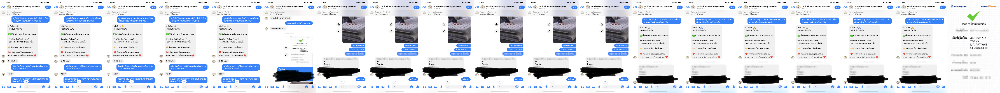

'16774'

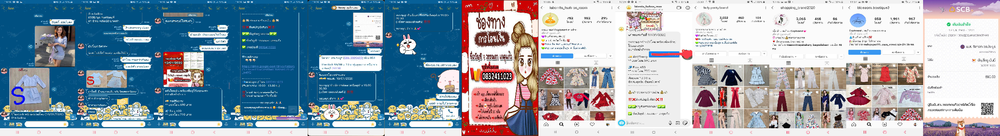

'16775'

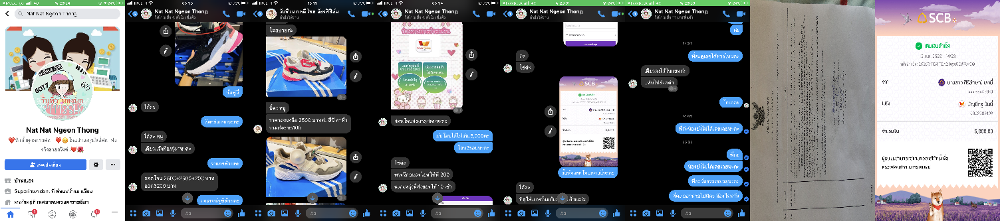

'16776'

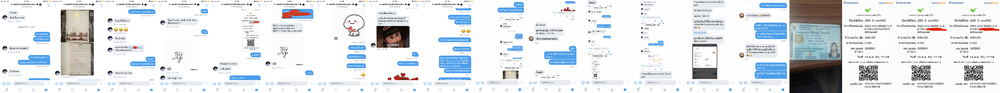

'16777'

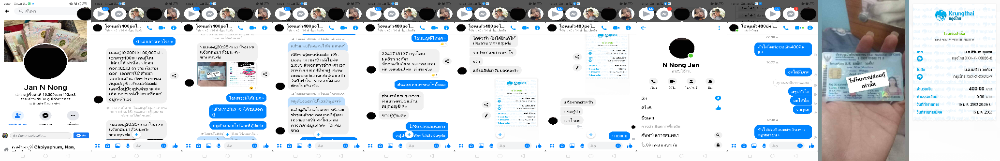

'16779'

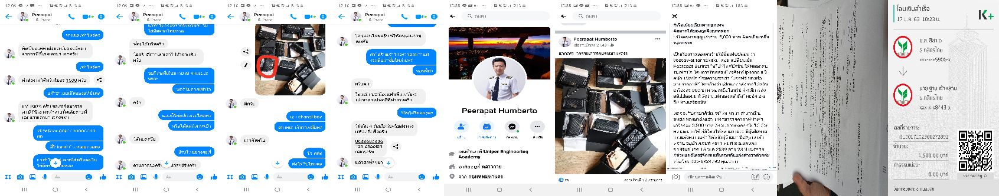

'16780'

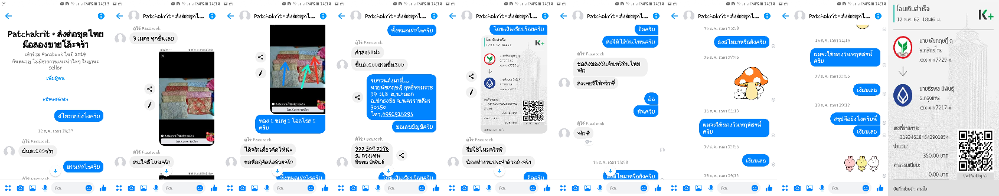

'16781'

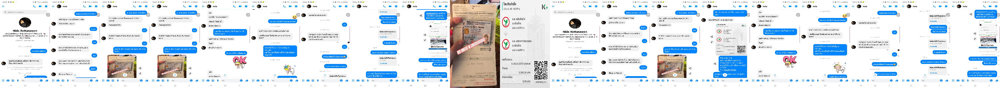

'16783'

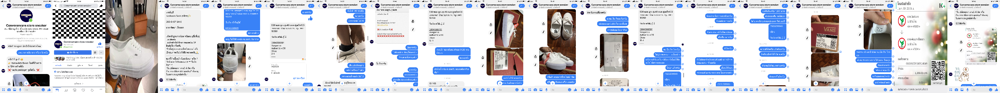

'16784'

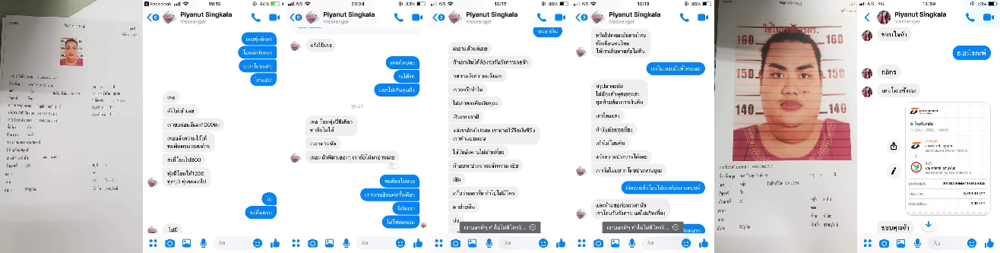

'16785'

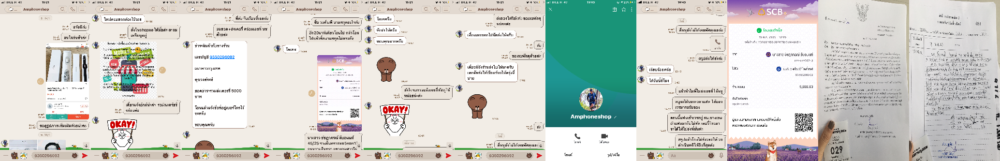

'16786'

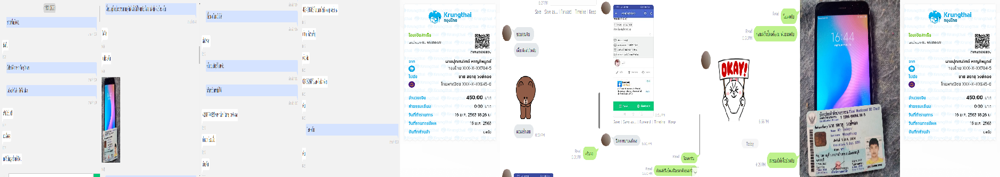

'16787'

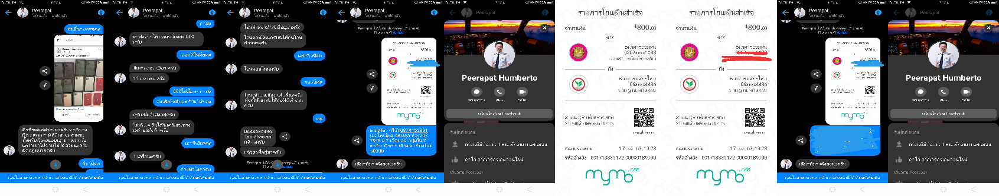

'16788'

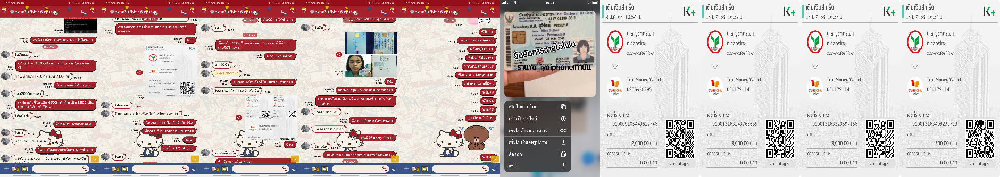

'16789'

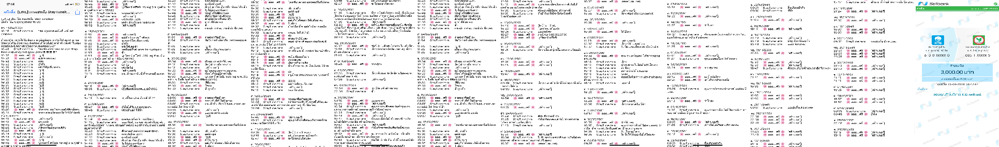

'16790'

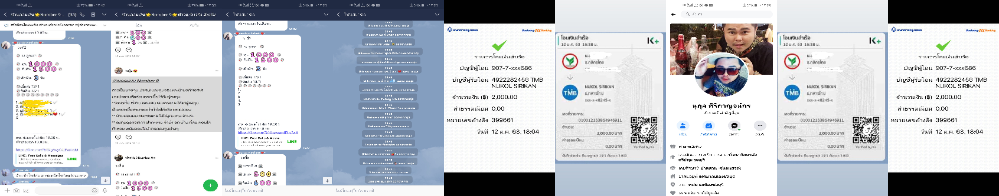

'16791'

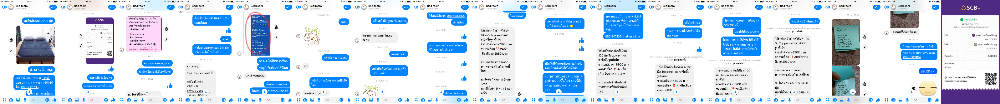

'16792'

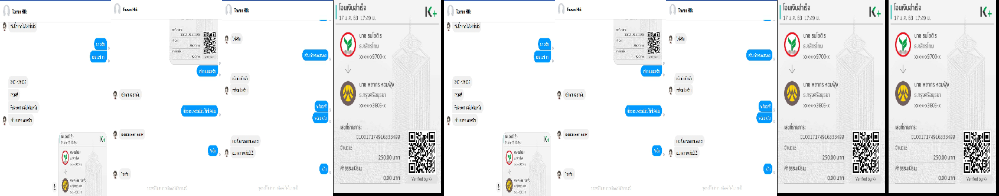

'16793'

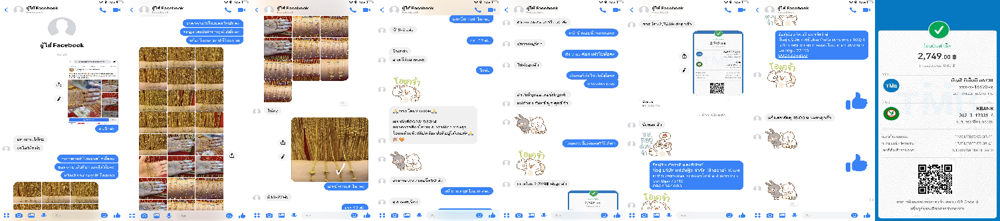

'16794'

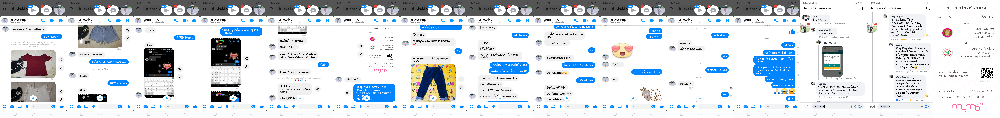

'16795'

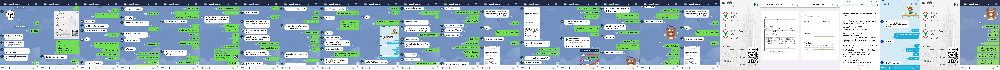

'16796'

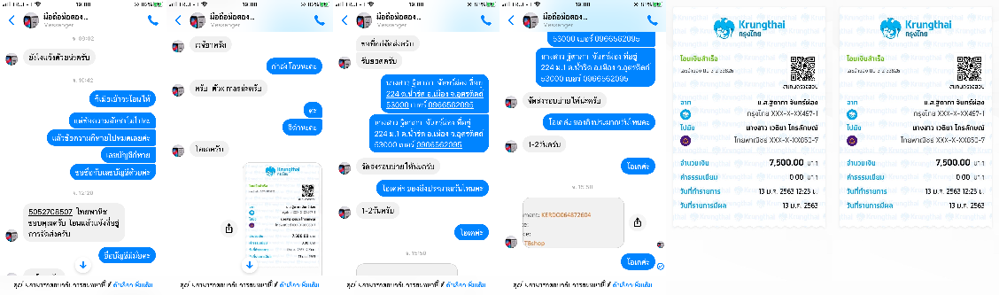

'16797'

Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened


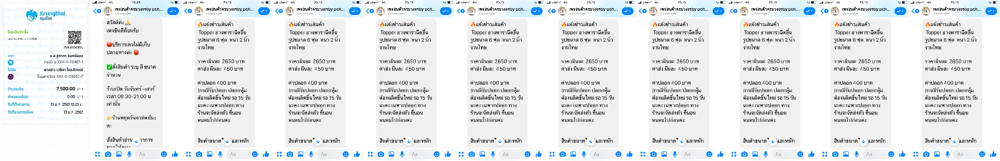

'16798'

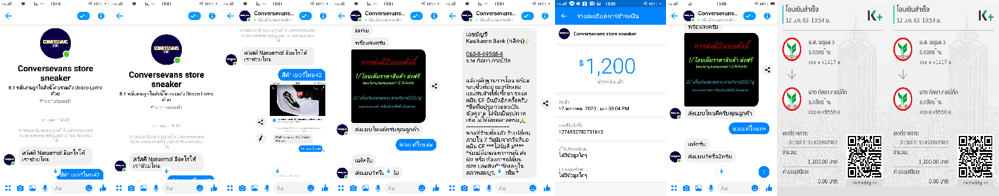

'16799'

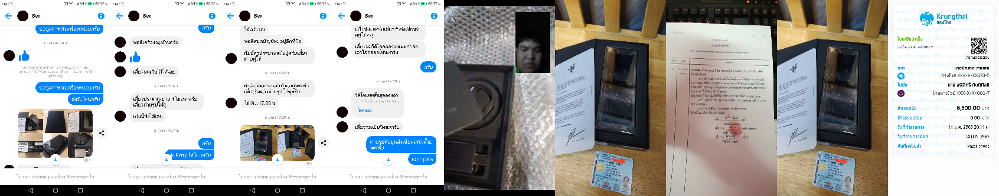

'16800'

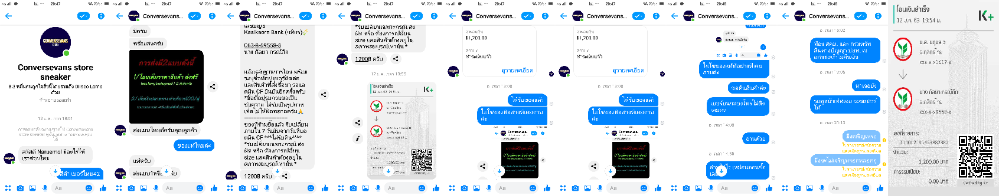

'16801'

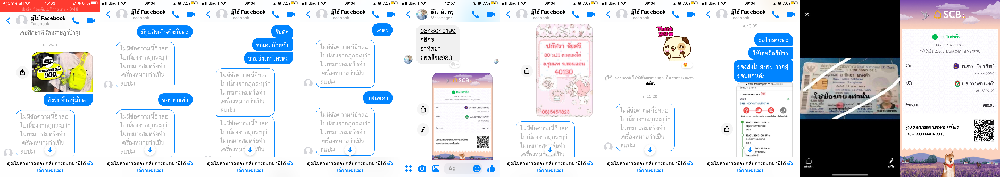

'16804'

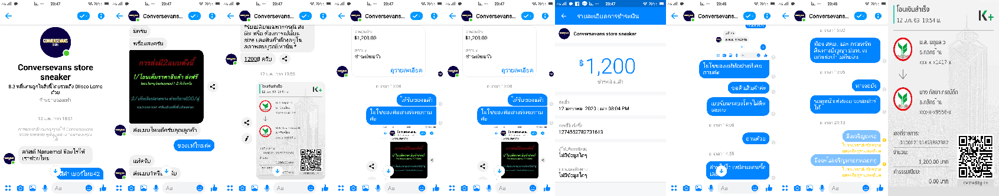

'16805'

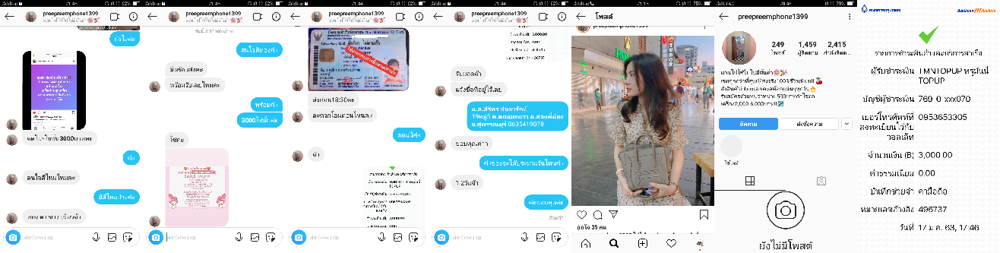

'16806'

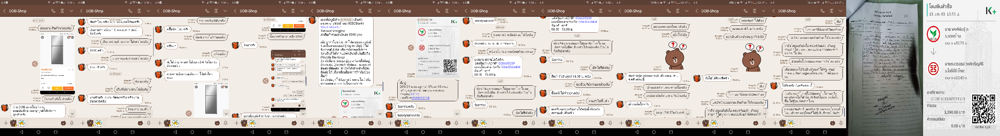

'16807'

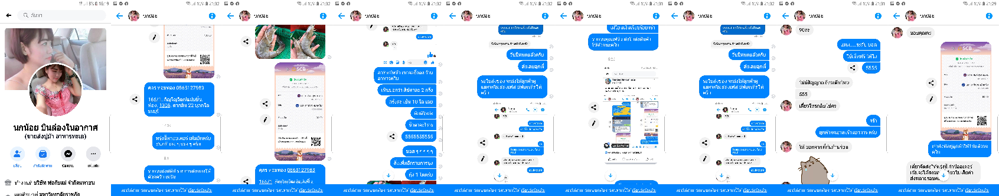

'16808'

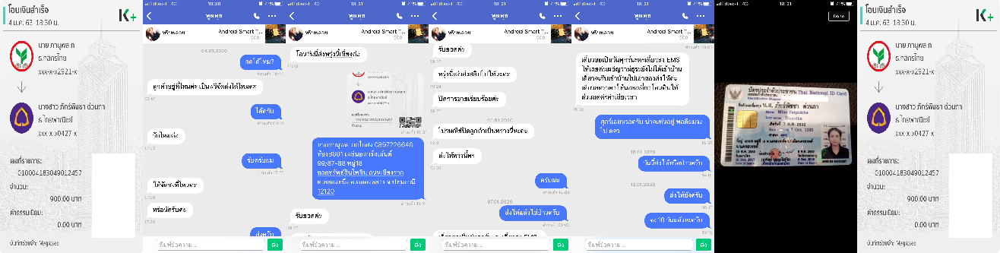

'16809'

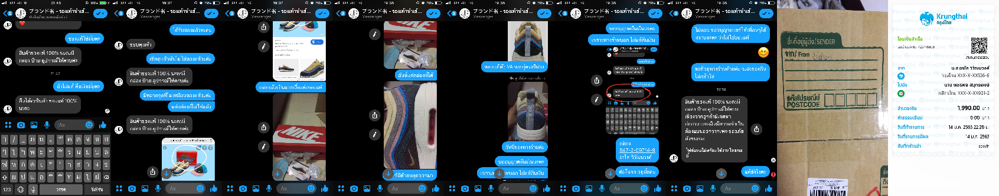

'16810'

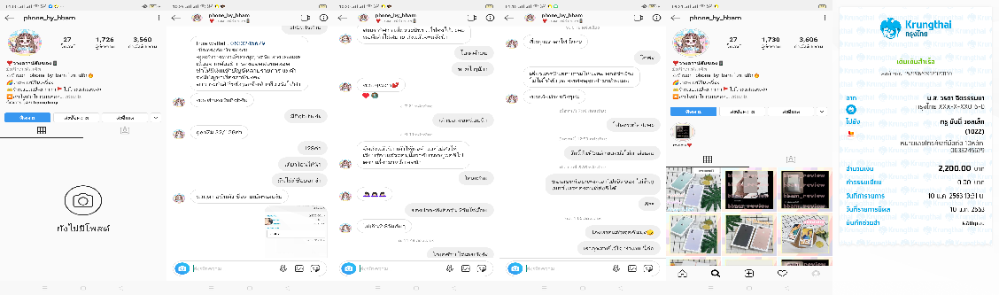

'16811'

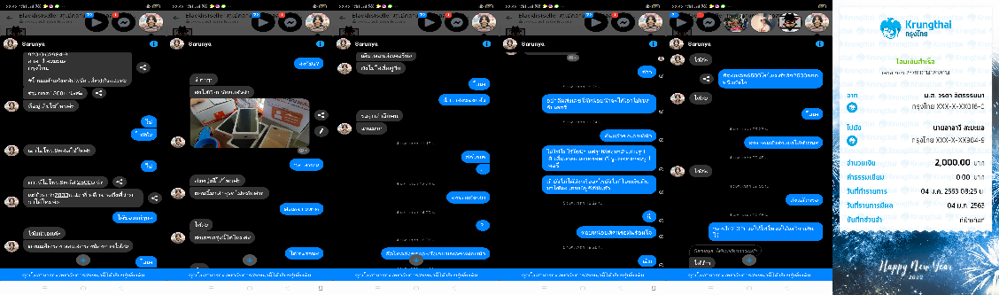

'16812'

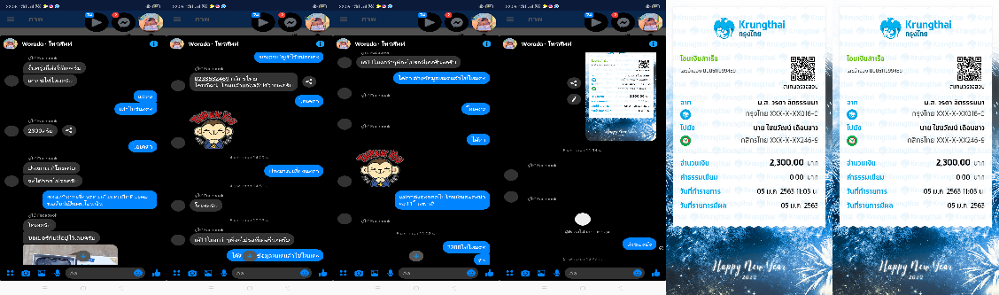

'16813'

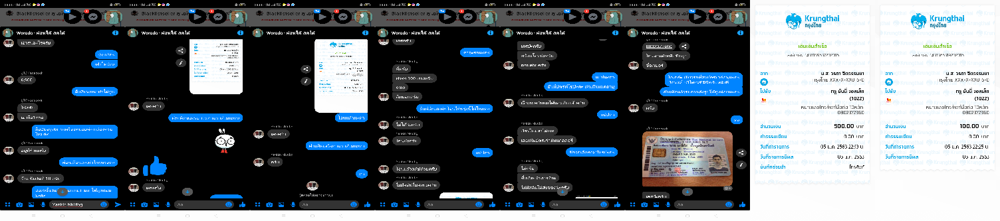

'16814'

Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened


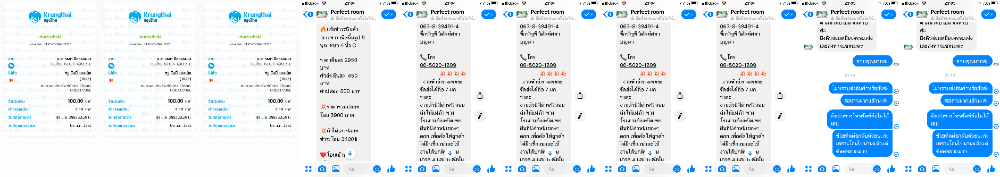

'16815'

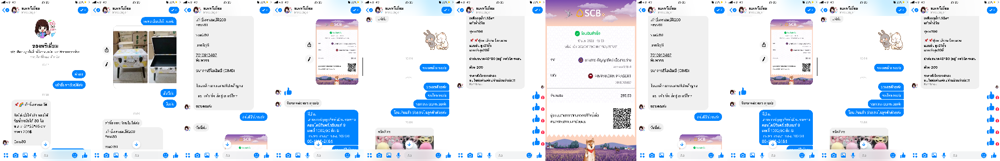

'16816'

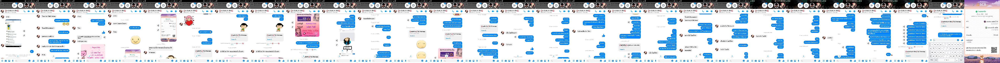

'16817'

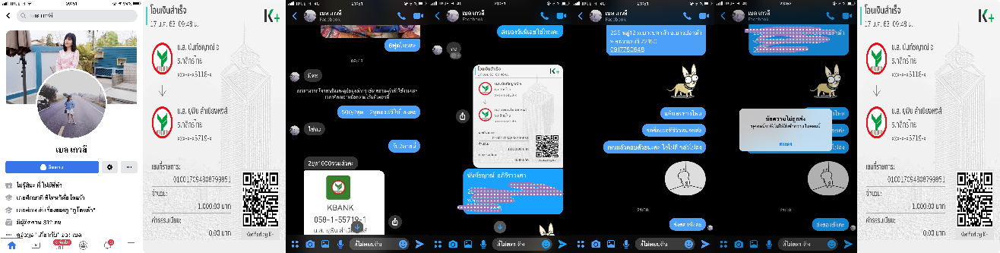

'16818'

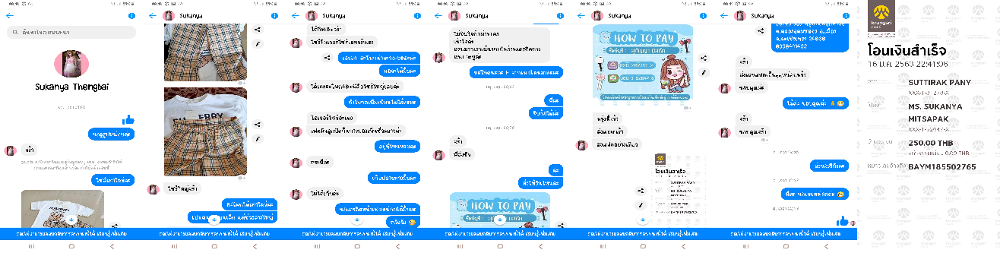

'16819'

Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened


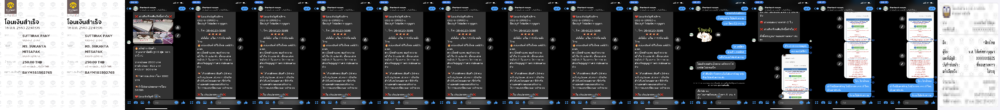

'16820'

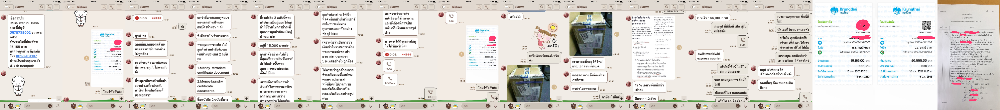

'16821'

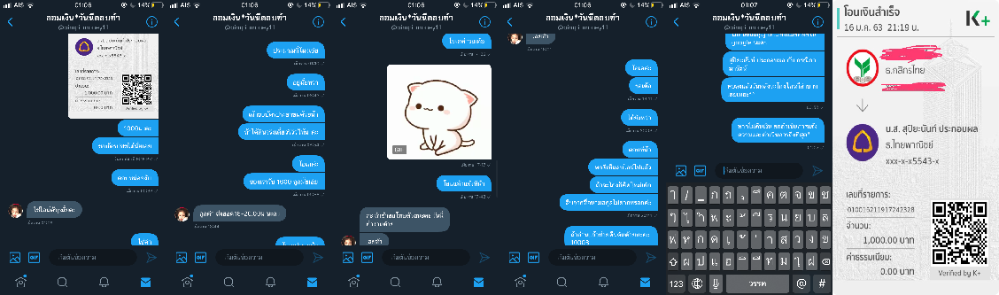

'16822'

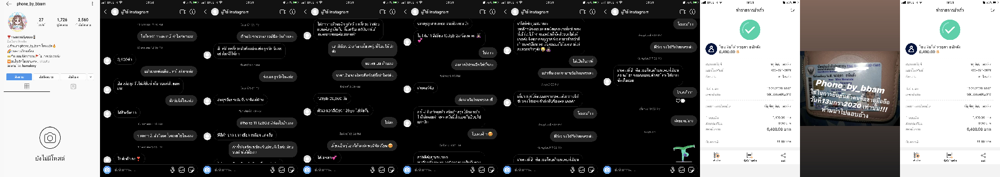

'16823'

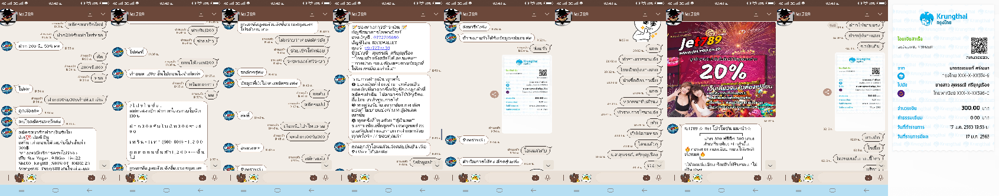

'16824'

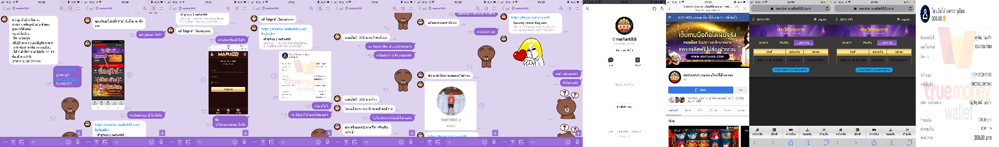

'16825'

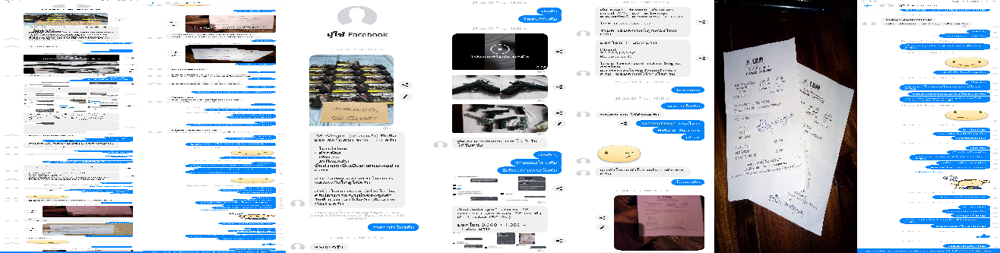

'16826'

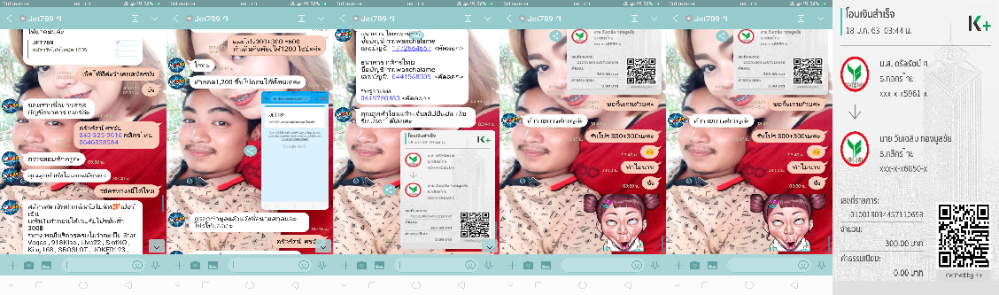

'16827'

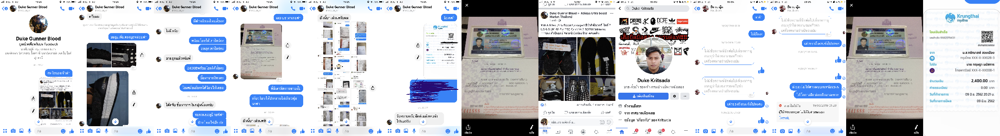

'16828'

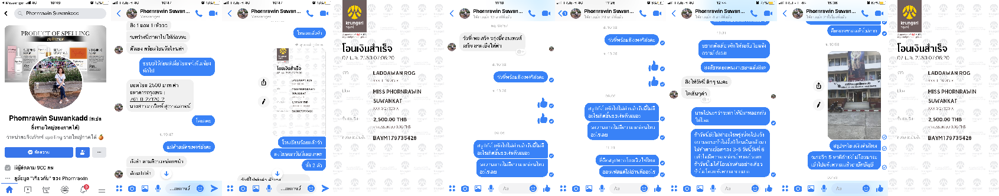

'16829'

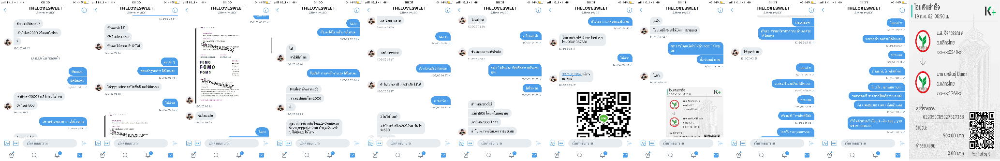

'16830'

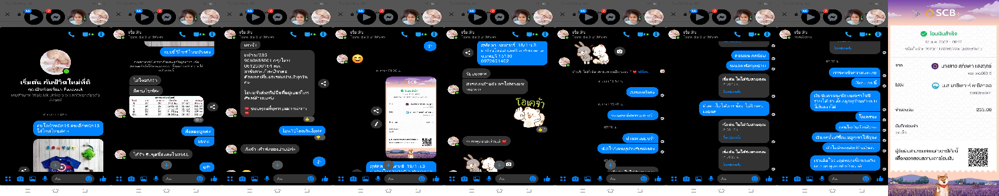

'16831'

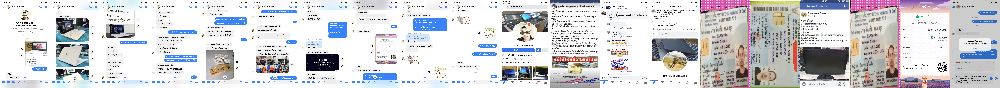

'16832'

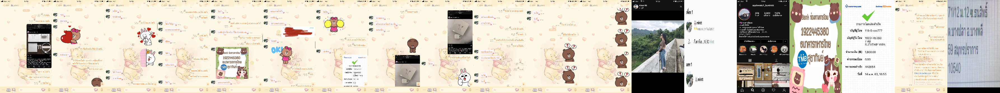

'16833'

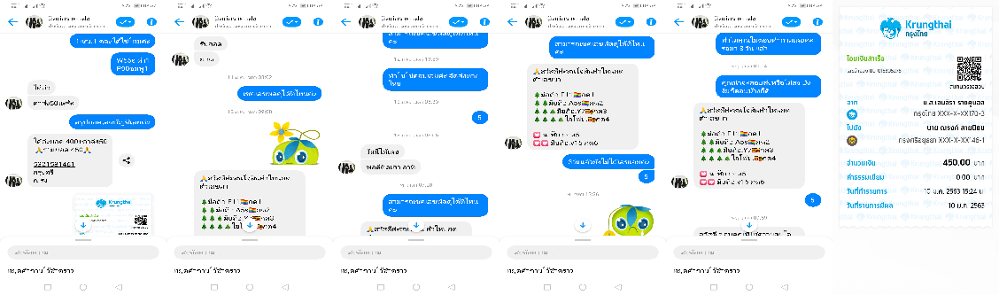

'16834'

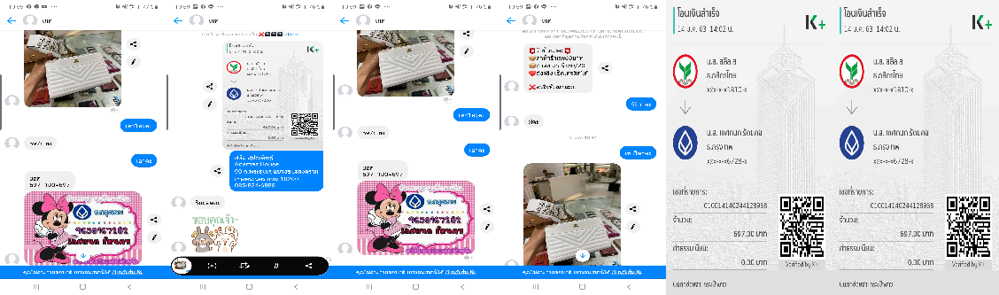

'16835'

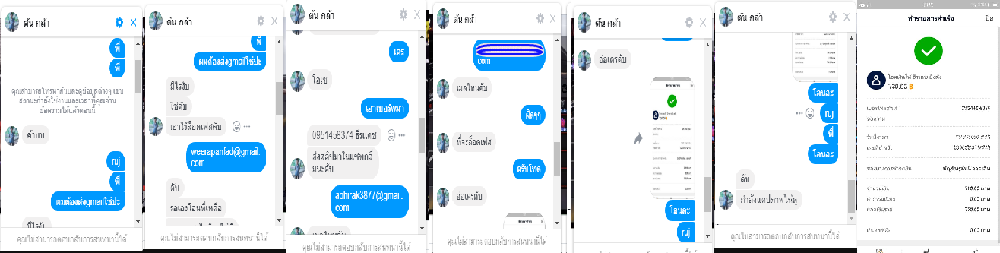

'16836'

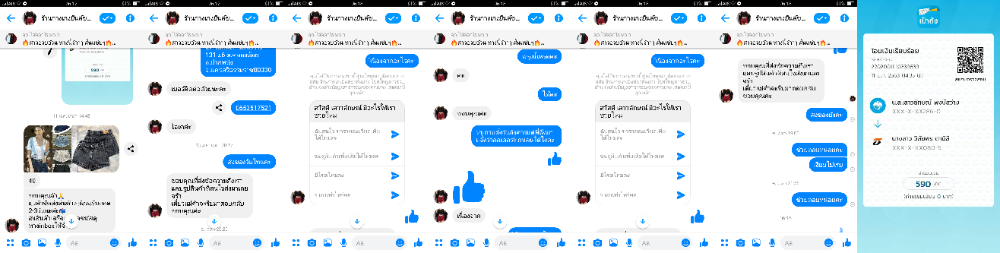

'16837'

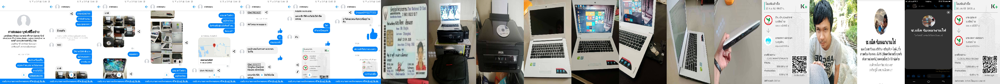

'16838'

Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened
Could not opened


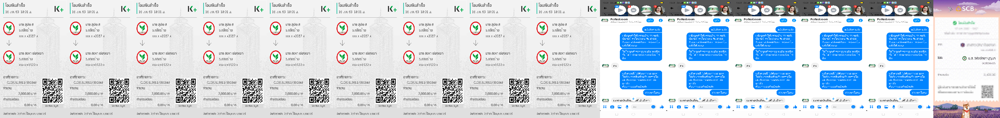

'16839'

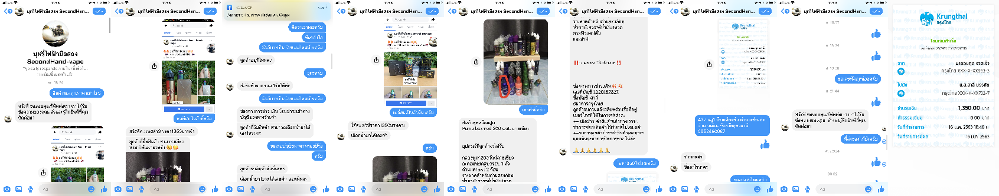

'16840'

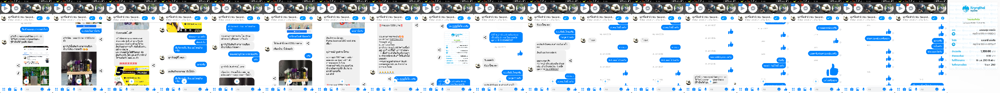

'16841'

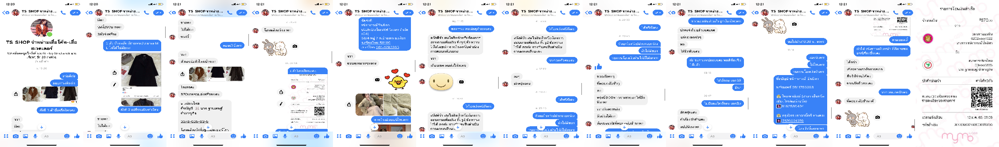

'16842'

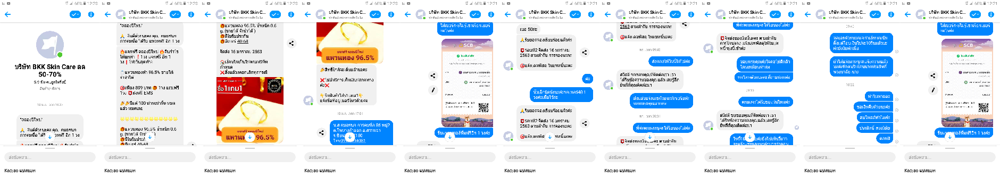

'16843'

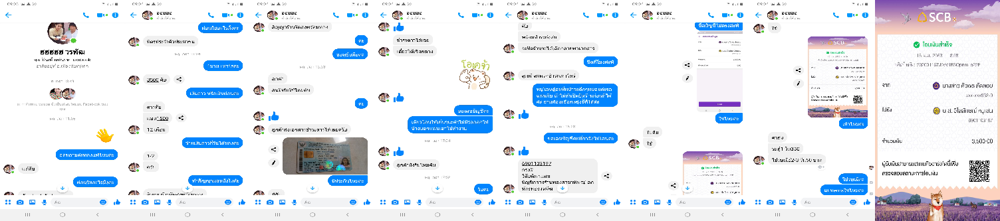

'16844'

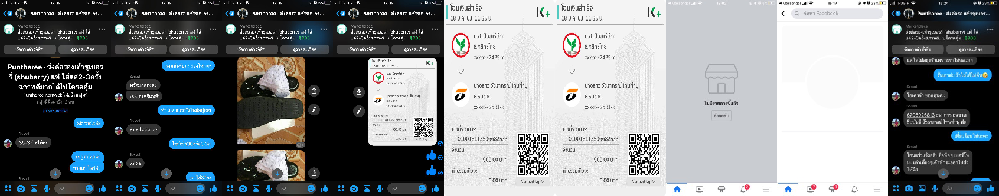

'16845'

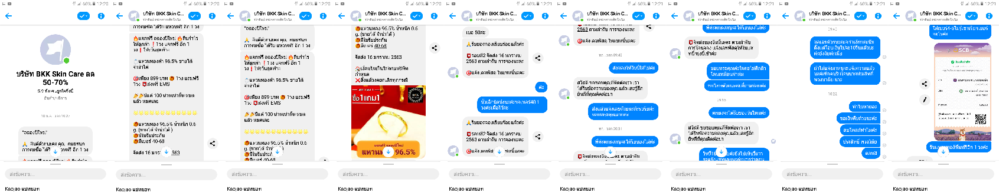

'16846'

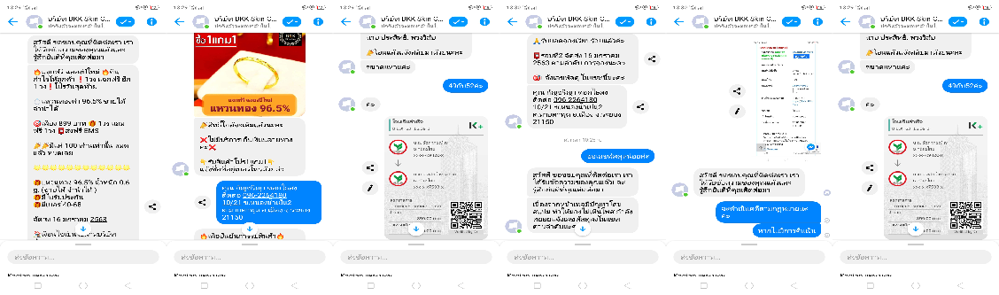

'16847'

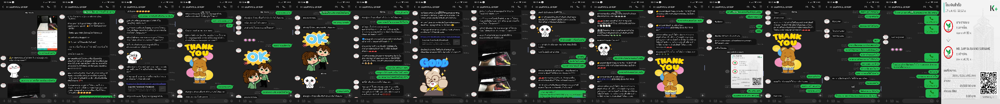

'16848'

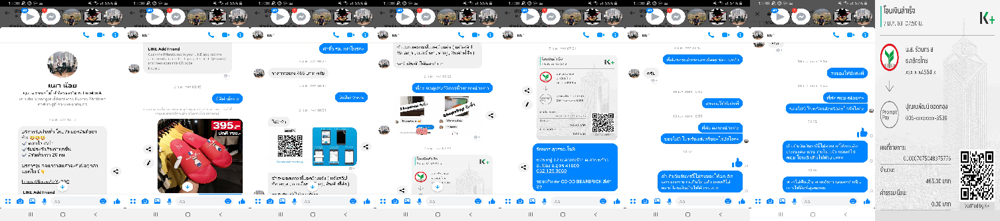

'16849'

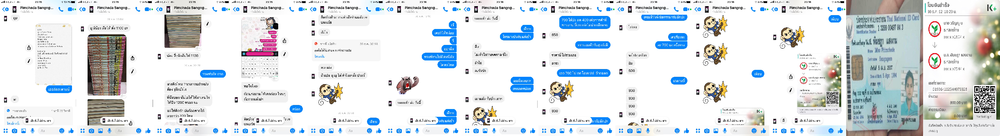

'16850'

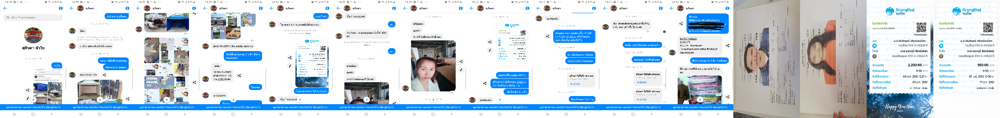

'16851'

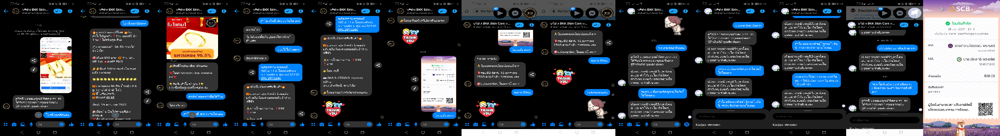

'16852'

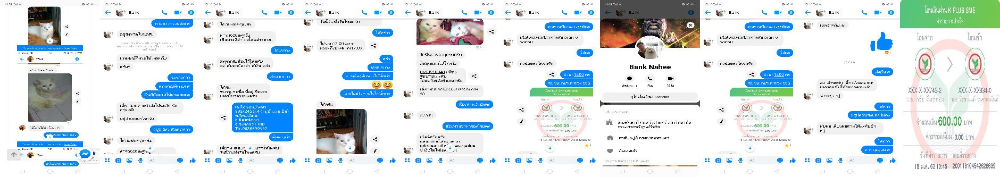

'16853'

In [ ]:
#Display report pictures
start_time = time.time()

test=[]
for x in group:
    z=0
    test=[]
    for y in range(len(x)):        
        url = "https://www.blacklistseller.com/assets/uploads/user_uploads_report/" + x[z]
        test.append(url)
        z+=1
        
    if x != []:
        x[z-1][1:6]
        x_offset = 0
        new_im = Image.new('RGB', (width*len(x),height))
        for x in test:
            response = requests.get(x)
            try:
                img = Image.open(BytesIO(response.content))
            except IOError:
                #print '%s could not be opened' % imagepath
                print("Could not opened")

            img = img.resize( (width , height), resample=0)

            new_im.paste(img, (x_offset,0))
            x_offset += width
        new_im

alldone()
print(round((time.time() - start_time)/60,2), " minutes running time")

# ============END==============

## Find user who create by report id

In [16]:
x = 16881    # report id to find

connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

TEXT = "SELECT tb_report.report_id, tb_user.user_id, tb_user.username, tb_user.facebook_id, tb_user.first_name, tb_user.last_name, tb_user.email, tb_user.phone_number, tb_report.first_name, tb_report.last_name FROM tb_report JOIN tb_user ON tb_report.user_id = tb_user.user_id WHERE tb_report.report_id = " + str(x)
mycursor.execute(TEXT)
result = mycursor.fetchall()
field_names = [i[0] for i in mycursor.description]
pd.DataFrame(result, columns=field_names)


,report_id,user_id,username,facebook_id,first_name,last_name,email,phone_number,first_name,last_name
0,16881,44762,,10158163926054626,Fern,Weeraya,0,,วิศัลย์ศยา,บุญมา


## Find user who create by seller lastname

In [30]:
x = "คุณชะ"  # seller lastname

connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

#Lastname
TEXT = "SELECT tb_report.report_id, tb_user.user_id, tb_user.username, tb_user.facebook_id, tb_user.first_name, tb_user.last_name, tb_user.email, tb_user.phone_number, tb_report.first_name, tb_report.last_name FROM tb_report JOIN tb_user ON tb_report.user_id = tb_user.user_id WHERE tb_report.last_name LIKE '%" + x +"%'"

#Firstname
#TEXT = "SELECT tb_report.report_id, tb_user.user_id, tb_user.username, tb_user.facebook_id, tb_user.first_name, tb_user.last_name, tb_user.email, tb_user.phone_number, tb_report.first_name, tb_report.last_name FROM tb_report JOIN tb_user ON tb_report.user_id = tb_user.user_id WHERE tb_report.first_name LIKE '%" + x +"%'"
TEXT
mycursor.execute(TEXT)
result = mycursor.fetchall()
field_names = [i[0] for i in mycursor.description]
df_user=pd.DataFrame(result, columns=field_names)
#df_user = df_user[['first_name','last_name']]
df_user.columns = ['report_id', 'user_id', 'username', 'facebook_id', 'first_name','last_name', 'email', 'phone_number', 'S_first_name', 'S_last_name']
df_user['seller name'] = df_user.iloc[:,-2] + " " + df_user.iloc[:,-1]
df_user.drop(['S_first_name','S_last_name'], axis=1, inplace = True)
df_user
FB=""
contact = ""
for index,row in df_user.iterrows():
    if row['username'] == "":
        FB = FB + row['first_name']+" "+row['last_name'] +"\n"
    else:
        contact = contact +"Name: "+ row['first_name'] +"  Email: "+ row['email']+"  Tel: "+row['phone_number'] +"\n"
            
print("Facebook user\n=================\n" +FB)
print("Non-Facebook user\n=================\n" +contact)

"SELECT tb_report.report_id, tb_user.user_id, tb_user.username, tb_user.facebook_id, tb_user.first_name, tb_user.last_name, tb_user.email, tb_user.phone_number, tb_report.first_name, tb_report.last_name FROM tb_report JOIN tb_user ON tb_report.user_id = tb_user.user_id WHERE tb_report.last_name LIKE '%คุณชะ%'"

,report_id,user_id,username,facebook_id,first_name,last_name,email,phone_number,seller name
0,7897,22396,0999025356,,วัชระพงษ์,ผ่านด่าน,watvharapong.123@gmail.com,0999025356,พิริยะ คุณชะ
1,8086,22845,,2314249881953927,Nann,Nutsinee,0,,พิริยะ คุณชะ
2,8193,23054,,2345083338884679,Pang,Arparat,0,,พิริยะ คุณชะ
3,12823,35822,Hatecheater,,Napapat,Srikamolthiti,terminalinsomnia@hotmail.com,0842495456,พิริยะ คุณชะ


Facebook user
Nann Nutsinee
Pang Arparat

Non-Facebook user
Name: วัชระพงษ์  Email: watvharapong.123@gmail.com  Tel: 0999025356
Name: Napapat  Email: terminalinsomnia@hotmail.com  Tel: 0842495456



## Search ALL report ID by seller name

In [29]:
connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

x= "ม่วงน้อย"   # either firstname or last name

TEXT = "SELECT report_id, first_name, last_name FROM tb_report WHERE first_name LIKE '%" + x +"%'" + "OR last_name LIKE '%" + x +"%'"

mycursor.execute(TEXT)
result = mycursor.fetchall()
field_names = [i[0] for i in mycursor.description]
pd.DataFrame(result, columns=field_names)


,report_id,first_name,last_name
0,13791,สุนิสา,ม่วงน้อย
1,14841,สุนิสา,ม่วงน้อย
2,15082,สุนิสา,ม่วงน้อย
3,16795,สุรัตดา,ม่วงน้อย


## xx

In [ ]:
connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()




## Find Report by user_ID

In [8]:
connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

x= 42886   # either firstname or last name


TEXT = "SELECT * FROM `tb_report` WHERE `user_id` =" + str(x) + " ORDER BY `report_id` ASC"

mycursor.execute(TEXT)
result = mycursor.fetchall()
field_names = [i[0] for i in mycursor.description]
pd.DataFrame(result, columns=field_names)


,report_id,user_id,product,price,first_name,last_name,idcard,active,create_date,detail_text,date,website,province_id,last_active,report_code


## Find all report create by username

In [15]:
x = "Asawarungruengchai"  # facebook user's lastname to find

connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

TEXT = "SELECT * from tb_user WHERE tb_user.last_name LIKE '%" + x +"%' ORDER BY create_date DESC "
#TEXT = "SELECT * from tb_user WHERE tb_user.last_name LIKE "+ x + " ORDER BY create_date DESC"
mycursor.execute(TEXT)
result = mycursor.fetchall()
field_names = [i[0] for i in mycursor.description]
df_user=pd.DataFrame(result, columns=field_names)
print("USER INFORMATION")
df_user

print("REPORT")
#LASTNAME
TEXT = "SELECT tb_report.report_id, tb_user.user_id, tb_user.username, tb_user.facebook_id, tb_user.first_name, tb_user.last_name, tb_user.email, tb_user.phone_number, tb_report.first_name, tb_report.last_name FROM tb_report JOIN tb_user ON tb_report.user_id = tb_user.user_id WHERE tb_user.last_name LIKE '%" + x +"%'"

#FIRSTNAME
# TEXT = "SELECT tb_report.report_id, tb_user.user_id, tb_user.username, tb_user.facebook_id, tb_user.first_name, tb_user.last_name, tb_user.email, tb_user.phone_number, tb_report.first_name, tb_report.last_name FROM tb_report JOIN tb_user ON tb_report.user_id = tb_user.user_id WHERE tb_user.first_name LIKE '%" + x +"%'"
mycursor.execute(TEXT)
result = mycursor.fetchall()
field_names = [i[0] for i in mycursor.description]
df_report=pd.DataFrame(result, columns=field_names)
print("REPORT INFORMATION")
df_report
df_report['report_id'].tolist()


USER INFORMATION


,user_id,username,first_name,last_name,email,create_date,active,facebook_id,password,pwd,...,last_active,is_delete,sid,user_pic,birthday,gender,province_id,is_thailand,not_thailand,user_level_id
0,40665,,Paiboon,Asawarungruengchai,0,2019-12-14 16:32:57,1,2858416794177985,,,...,2020-01-15 23:13:18,0,,,None,1,0,1,,4
1,24315,,Paiboon,Asawarungruengchai,0,2019-07-14 22:05:39,1,2541975135822154,,,...,2019-11-03 20:50:26,0,,,None,1,0,1,,4


REPORT
REPORT INFORMATION


,report_id,user_id,username,facebook_id,first_name,last_name,email,phone_number,first_name,last_name
0,8643,24315,,2541975135822154,Paiboon,Asawarungruengchai,0,,ณัฎฐวัฒน์,สินสวัสดิ์
1,9618,24315,,2541975135822154,Paiboon,Asawarungruengchai,0,,ศราวุธ,มาลากุล


[8643, 9618]

### Fix owner of report

In [24]:
connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

print("Report to FIX? (!seperate by comma)")
report_to_fix = input()
report_to_fix = report_to_fix.split(',')
print("User ID?")
userid = input()
userid=userid.strip()

for x in report_to_fix:
    x=x.strip()
    #TEXT = "UPDATE tb_report SET active = 0 WHERE tb_report.report_id = " + str(x)
    TEXT = "UPDATE tb_report SET user_id = "+ userid + " WHERE report_id = "+ str(x)
    TEXT
    mycursor.execute(TEXT)
    connection.commit()

Report to FIX? (!seperate by comma)
    8643  , 9618  
User ID?
  40665  


'UPDATE tb_report SET user_id = 40665 WHERE report_id = 8643'

'UPDATE tb_report SET user_id = 40665 WHERE report_id = 9618'

## Find all report by bank account

In [43]:
x = "014000000562934"  # Bank A/C

connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

#Lastname
TEXT = "SELECT tb_report.report_id,tb_report.active, tb_report.first_name, tb_report.last_name, tb_report_bank.bank_number FROM tb_report JOIN tb_report_bank ON tb_report.report_id = tb_report_bank.report_id WHERE tb_report_bank.bank_number = "+ str(x)

mycursor.execute(TEXT)
result = mycursor.fetchall()
field_names = [i[0] for i in mycursor.description]
df=pd.DataFrame(result, columns=field_names)
# df_user.columns = ['report_id', 'user_id', 'username', 'facebook_id', 'first_name','last_name', 'email', 'phone_number', 'S_first_name', 'S_last_name']
# df_user['seller name'] = df_user.iloc[:,-2] + " " + df_user.iloc[:,-1]
# df_user.drop(['S_first_name','S_last_name'], axis=1, inplace = True)
df

,report_id,active,first_name,last_name,bank_number
0,11149,1,ปวีณา,โชติธนภาคย์,014000000562934
1,11165,1,ปวีณา,โชติธนภาคย์,014000000562934
2,11149,1,ปวีณา,โชติธนภาคย์,014000000562934
3,11149,1,ปวีณา,โชติธนภาคย์,014000000562934
4,12197,1,ปวีณา,โชติธนภาคย์,014000000562934
5,12197,1,ปวีณา,โชติธนภาคย์,014000000562934
6,12197,1,ปวีณา,โชติธนภาคย์,014000000562934
7,12700,1,ปวีณา,โชติธนภาคย์,014000000562934
8,12771,0,ปวีณา,โชติธนภาคย์,014000000562934
9,12949,1,ปวีณา,โชติธนภาคย์,014000000562934


In [45]:
# BEWARE : Correct seller name and detail based on report_id
connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

for x in df['report_id']:
    TEXT = "UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = " + str(x)
    TEXT
    mycursor.execute(TEXT)
    connection.commit()
    
    
    TEXT2 = "UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = " + str(x)
    TEXT2
    mycursor.execute(TEXT2)
    connection.commit()


"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 11149"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 11149"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 11165"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 11165"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 11149"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 11149"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 11149"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 11149"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 12197"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 12197"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 12197"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 12197"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 12197"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 12197"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 12700"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 12700"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 12771"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 12771"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 12949"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 12949"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 13067"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 13067"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 13131"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 13131"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 13096"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 13096"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 13131"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 13131"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 13131"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 13131"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 13224"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 13224"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 13224"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 13224"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 14752"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 14752"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 14752"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 14752"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 15996"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 15996"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 15996"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 15996"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 15996"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 15996"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 15996"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 15996"

"UPDATE tb_report SET first_name = 'อชิรญาณ์' ,last_name = 'ฉ่ำช้าง' WHERE tb_report.report_id = 15996"

"UPDATE tb_report SET detail_text = CONCAT(' ประกาศ!! ประสานงานกับตำรวจและพบบุคคลโกงตัวจริงแล้ว ชื่อ น.ส.อชิรญาณ์ ฉ่ำช้าง ยังเป็นเด็กนักเรียนจังหวัดชัยนาท พบว่ามีบชส่วนตัวคือ SCB เลข 6152323952 สาขาชัยนาท เบอร์โทร 0902920410 และที่ผ่านมาได้แอบอ้างคนชื่อปวีณา ให้ตกเป็นแพะรับบาปแทน ตอนนี้สาวถึงตัวคนโกงตัวจริงเรียบร้อย   | ', detail_text) WHERE tb_report.report_id = 15996"

## Find most freq name recently

In [ ]:
connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

TEXT = "SELECT count(*),first_name,last_name FROM tb_report where report_id IN (SELECT report_id FROM `tb_report` WHERE create_date >= (CURRENT_TIMESTAMP()-60*60*24*2)) GROUP by last_name order by count(*) DESC limit 10"
TEXT
mycursor.execute(TEXT)
result = mycursor.fetchall()
field_names = [i[0] for i in mycursor.description]
pd.DataFrame(result, columns=field_names)

## Set report_active = 0

In [173]:
to_disable = ""
print("Report_ID to set active = 0")
to_disable = input()
print("Special reason to delete?")
reason = ""
reason = input() 

connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

TEXT = "UPDATE `tb_report` SET `active` = '0' WHERE `tb_report`.`report_id` = " + str(to_disable)

print(TEXT)
mycursor.execute(TEXT)
connection.commit()

TEXT = "UPDATE tb_report SET detail_text = CONCAT(' "+ reason + " | ', detail_text) WHERE `tb_report`.`report_id` = " + str(to_disable) +";"
TEXT
mycursor.execute(TEXT)
connection.commit()      

Report_ID to set active = 0
13527
Special reason to delete?
ติดต่อแอดมินมา โดนใส่ร้าย ไม่มีหลักฐานอะไรเลย
UPDATE `tb_report` SET `active` = '0' WHERE `tb_report`.`report_id` = 13527


"UPDATE tb_report SET detail_text = CONCAT(' ติดต่อแอดมินมา โดนใส่ร้าย ไม่มีหลักฐานอะไรเลย | ', detail_text) WHERE `tb_report`.`report_id` = 13527;"

## To display specific report picture

'มลิษา ชนะรัตน์'

Number of picture: 6


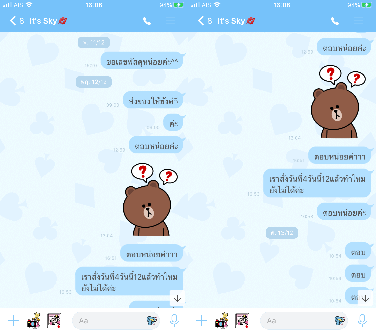

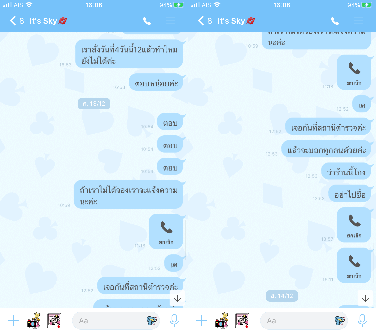

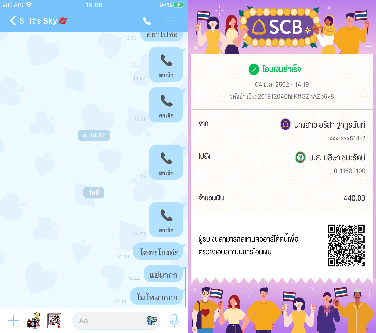

In [35]:
to_display = 14817  

#display name
response = requests.get("https://www.blacklistseller.com/report/report_preview/" + str(to_display))
soup = BeautifulSoup(response.text, 'html.parser')
linetoscreen = str(soup.findAll('a')[5])
name = linetoscreen.split("</a>")[0].split('>')[1]
name

list_of_report = file[(file['report_id'] == to_display) & (file['report_item_active'] == 1)]['report_item_filename'].values.tolist()
print(f'Number of picture: {len(list_of_report)}')
link=[]
for x in list_of_report:
    url = "https://www.blacklistseller.com/assets/uploads/user_uploads_report/" + x
    link.append(url)

split_by = round(len(link)/3)
link1 = link[0:split_by]
link2 = link[split_by:split_by*2]
link3 = link[split_by*2:]
sum_link = []
sum_link.append(link1)
sum_link.append(link2)
sum_link.append(link3)

for y in sum_link:    
    x_offset = 0
    new_im = Image.new('RGB', (width*len(y),height))
    for x in y:
        response = requests.get(x)

        #img = Image.open(BytesIO(response.content))
        #img = img.resize( (width , height), resample=0)
        try:
            img = Image.open(BytesIO(response.content))
        except IOError:
            #print '%s could not be opened' % imagepath
            print("Could not opened")

        img = img.resize( (width , height), resample=0)

        new_im.paste(img, (x_offset,0))
        x_offset += width
    new_im        
    


In [5]:
#PREPARE TB_REPORT

connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

mycursor.execute("select * from tb_report")
result = mycursor.fetchall()
field_names = [i[0] for i in mycursor.description]  #Column name
tb_report = pd.DataFrame(result, columns=field_names)

#prepare tb_report
df = tb_report[['report_id','first_name','last_name','idcard']]
df['fullname'] = df['first_name']+ " " + df['last_name']

#Create df_count with 4 freq
df_count=pd.DataFrame(df['fullname'].value_counts()>=4)
df_count= df_count[df_count['fullname'] == True]
df_count.reset_index(inplace = True)
df_count.drop('fullname', axis=1, inplace = True)
df_count.rename(columns={'index':'fullname'}, inplace=True )

## DELETE report pics + db

In [12]:
connect_ftp()

connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

to_delete = ""
reason = ""
name=""
override = ""

to_delete = input()
to_delete = to_delete.split()
print("ลบด้วยเหตุผลพิเศษ?")
reason = input()

print("Type anything to override freq name check? ")
override = input()

#Check freq of fullname and remove if feq name in report already
report_tonot_delete = []

if override == "":    
    for x in to_delete:
        name = df[df['report_id']==int(x)].iloc[0,4]
        if name in df_count.values:
            to_delete.remove(x)
            report_tonot_delete.append(x)            
        
print(f'Report that will not deleted due to multiple report already:--> {report_tonot_delete}')
print("\n")
print("List of report_id to delete " + str(to_delete))
print("\n")
print("=========================")

df_prepare_to_del = file[(file['report_id'].isin(to_delete))]
file_to_del = df_prepare_to_del['report_item_filename'].values.tolist()
    
#delete files    
for x in file_to_del:    
    print("ftp.delete('" + x + "')")            
    try:
        ftp.delete(x)
    except error_perm:
        print("!!  file already deleted")
    
SQL = "" #SQL code to delete report
for x in to_delete:
    TEXT = "UPDATE tb_report SET active = 0 WHERE tb_report.report_id = " + str(x)
    TEXT
    mycursor.execute(TEXT)
    connection.commit()

    #Delete db record
    TEXT = "DELETE FROM tb_report_item WHERE tb_report_item.report_id = " + str(x)
    TEXT
    mycursor.execute(TEXT)
    connection.commit()
    
    #Add detail text
    if reason == "":
        TEXT = "UPDATE tb_report SET detail_text = CONCAT(' !รายงานถูกลบเนื่องจากรายละเอียดไม่เพียงพอ! | ', detail_text) WHERE `tb_report`.`report_id` = " + str(x) +";"
        TEXT
        mycursor.execute(TEXT)
        connection.commit()
    else:
        TEXT = "UPDATE tb_report SET detail_text = CONCAT(' "+ str(reason)+ " | ', detail_text) WHERE `tb_report`.`report_id` = " + str(x) +";"
        TEXT
        mycursor.execute(TEXT)
        connection.commit()            



ลบด้วยเหตุผลพิเศษ?

Type anything to override freq name check? 

Report that will not deleted due to multiple report already:--> []


List of report_id to delete []




## DELETE specific pic by filename

In [6]:
#Delete specific file name

connect_ftp()

connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

to_delete = "[14497]_17.jpg"
#to_delete = input()

try:
    ftp.delete(to_delete)
except error_perm:
    print("!!  file already deleted")
    
TEXT = "DELETE FROM tb_report_item WHERE tb_report_item.report_item_filename = '" + to_delete +"'"
TEXT
mycursor.execute(TEXT)
connection.commit()

!!  file already deleted


"DELETE FROM tb_report_item WHERE tb_report_item.report_item_filename = '[14497]_17.jpg'"

## Clean tb_report

In [12]:
connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

mycursor.execute("select * from tb_report")
result = mycursor.fetchall()
field_names = [i[0] for i in mycursor.description]  #Column name
tb_report = pd.DataFrame(result, columns=field_names)

df = tb_report[['report_id','first_name','last_name','idcard']]
df['fullname'] = df['first_name']+ " " + df['last_name']

### Fuzzzywuzzy : detect wrong name

In [15]:
from fuzzywuzzy import fuzz
df_master=df['fullname'].value_counts().head(980)
df_master.tail()

ณรญา กลิ่นเจริญ       2
เบญญาภา ปทุมานนท์     2
ประไพ คำภาสิทธิ์      2
จีระพรรณ เชื้อกลาง    2
รัฐภูมิ เเซ่ลอ        2
Name: fullname, dtype: int64

In [16]:
df_master = pd.DataFrame(df_master)
df_master.rename({'fullname':'count'}, inplace=True )
df_master['fullname'] = df_master.index
df_master.reset_index(level=0, inplace=True)
df_master.drop('index', axis=1, inplace = True)

df_to_clean = df[~df.fullname.isin(df_master.fullname)]
df_to_clean.shape

(6145, 5)

### Start using Fuzzy

In [25]:
start_time = time.time()
i=1
SQL = ""
SQL_to_txt = ""
explain=""
for index, row in df_to_clean.iterrows():
    for y in df_master['fullname']:
        score = fuzz.ratio(row['fullname'],y)
        if ( score >= 90) and ( score != 100):
            name = y.split()
            TEXT = "UPDATE tb_report SET first_name ='"+name[0]+"',"+"last_name = '"+name[1]+"'"+" WHERE tb_report.report_id = "+str(row['report_id'])+";!"
            TEXT
            SQL=SQL+TEXT
            print(i, "Report ID :", row['report_id']," |  Score:",score,"  \nผิด --> ",row['fullname'],"  \nถูก --> ",y,"\n")
            explain = "# "+str(i)+ " Report ID : "+ str(row['report_id'])+" | Score:"+str(score) + "  ผิด --> " + str(row['fullname'])+"|  ถูก --> " + str(y) +" \n\n"                    
            SQL_to_txt = SQL_to_txt + TEXT + explain
            i+=1

alldone()
print(round((time.time() - start_time)/60,2), " minutes running time")

"UPDATE tb_report SET first_name ='สุรศักดิ์',last_name = 'เหล่าบัณฑิตเจริญ' WHERE tb_report.report_id = 15742;!"

1 Report ID : 15742 | Score: 98   
ผิด -->  สุรศักดิ เหล่าบัณฑิตเจริญ   
ถูก -->  สุรศักดิ์ เหล่าบัณฑิตเจริญ 



"UPDATE tb_report SET first_name ='สมพิศ',last_name = 'ชาติกระโทก' WHERE tb_report.report_id = 16669;!"

1 Report ID : 16669 | Score: 94   
ผิด -->  สมพิศ ชาติกาะโทก   
ถูก -->  สมพิศ ชาติกระโทก 



"UPDATE tb_report SET first_name ='ทิพภาภรณ์',last_name = 'ทะนันชัย' WHERE tb_report.report_id = 16673;!"

1 Report ID : 16673 | Score: 95   
ผิด -->  ทิพย์ภาภรณ์ ทะนันชัย   
ถูก -->  ทิพภาภรณ์ ทะนันชัย 



"UPDATE tb_report SET first_name ='ภืญญา',last_name = 'ยืนยิ่ง' WHERE tb_report.report_id = 16703;!"

1 Report ID : 16703 | Score: 92   
ผิด -->  ภิญญา ยืนยิ่ง   
ถูก -->  ภืญญา ยืนยิ่ง 



"UPDATE tb_report SET first_name ='อาทิตยา',last_name = 'แพ่งคำ' WHERE tb_report.report_id = 16707;!"

1 Report ID : 16707 | Score: 97   
ผิด -->  อาทิตยา​ แพ่งคำ   
ถูก -->  อาทิตยา แพ่งคำ 



"UPDATE tb_report SET first_name ='ณัฏฐ์ชพงษ์',last_name = 'ชายเขียว' WHERE tb_report.report_id = 16722;!"

1 Report ID : 16722 | Score: 95   
ผิด -->  ณัฎฐ์ชพงษ์ ชายเขียว   
ถูก -->  ณัฏฐ์ชพงษ์ ชายเขียว 



"UPDATE tb_report SET first_name ='เวติยา',last_name = 'ไกรลักษณ์' WHERE tb_report.report_id = 16796;!"

1 Report ID : 16796 | Score: 94   
ผิด -->  เวติยา ไทรลักษณ์   
ถูก -->  เวติยา ไกรลักษณ์ 



"UPDATE tb_report SET first_name ='วิลัยพร',last_name = 'ดามิลี' WHERE tb_report.report_id = 16836;!"

1 Report ID : 16836 | Score: 93   
ผิด -->  วิลัยพร ดามิลร   
ถูก -->  วิลัยพร ดามิลี 



50.38  minutes running time


In [26]:
%%capture
#Write output list to textfile

SQL_list = SQL_to_txt.split('!')
text_file = open("sql_changename.txt", encoding="utf-8", mode="w")
for x in SQL_list:
    text_file.write(x + "\n")
#text_file.write(SQL)
text_file.close()

### Execute SQL command to fix wrong name

In [28]:
#Without Confirmation!!   (under coding fix)
connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

SQL_list = SQL.split('!')
#SQL_list
for x in SQL_list:
    x
    mycursor.execute(x)
    connection.commit()

"UPDATE tb_report SET first_name ='สุรศักดิ์',last_name = 'เหล่าบัณฑิตเจริญ' WHERE tb_report.report_id = 15742;"

"UPDATE tb_report SET first_name ='สมพิศ',last_name = 'ชาติกระโทก' WHERE tb_report.report_id = 16669;"

"UPDATE tb_report SET first_name ='ทิพภาภรณ์',last_name = 'ทะนันชัย' WHERE tb_report.report_id = 16673;"

"UPDATE tb_report SET first_name ='ภืญญา',last_name = 'ยืนยิ่ง' WHERE tb_report.report_id = 16703;"

"UPDATE tb_report SET first_name ='อาทิตยา',last_name = 'แพ่งคำ' WHERE tb_report.report_id = 16707;"

"UPDATE tb_report SET first_name ='ณัฏฐ์ชพงษ์',last_name = 'ชายเขียว' WHERE tb_report.report_id = 16722;"

"UPDATE tb_report SET first_name ='เวติยา',last_name = 'ไกรลักษณ์' WHERE tb_report.report_id = 16796;"

"UPDATE tb_report SET first_name ='วิลัยพร',last_name = 'ดามิลี' WHERE tb_report.report_id = 16836;"

''

In [21]:
#With Confimration

connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

SQL_list = SQL.split('!')
#SQL_list
for x in SQL_list:
    cancel = ""
    x
    print("enter to exec / key anything to cancel :")
    cancel = input()
    if cancel == "":    
        mycursor.execute(x)
        connection.commit()
    else:
        print('Skip replacing name')

"UPDATE tb_report SET first_name ='สุรศักดิ์',last_name = 'เหล่าบัณฑิตเจริญ' WHERE tb_report.report_id = 15742;"

enter to del / key anything to cancel :



"# 1 Report ID : 15742| Score:98  ผิด --> สุรศักดิ เหล่าบัณฑิตเจริญ ถูก --> สุรศักดิ์ เหล่าบัณฑิตเจริญ \nUPDATE tb_report SET first_name ='สมพิศ',last_name = 'ชาติกระโทก' WHERE tb_report.report_id = 16669;"

enter to del / key anything to cancel :



"# 1 Report ID : 16669| Score:94  ผิด --> สมพิศ ชาติกาะโทก ถูก --> สมพิศ ชาติกระโทก \nUPDATE tb_report SET first_name ='ทิพภาภรณ์',last_name = 'ทะนันชัย' WHERE tb_report.report_id = 16673;"

enter to del / key anything to cancel :



"# 1 Report ID : 16673| Score:95  ผิด --> ทิพย์ภาภรณ์ ทะนันชัย ถูก --> ทิพภาภรณ์ ทะนันชัย \nUPDATE tb_report SET first_name ='ภืญญา',last_name = 'ยืนยิ่ง' WHERE tb_report.report_id = 16703;"

enter to del / key anything to cancel :



"# 1 Report ID : 16703| Score:92  ผิด --> ภิญญา ยืนยิ่ง ถูก --> ภืญญา ยืนยิ่ง \nUPDATE tb_report SET first_name ='อาทิตยา',last_name = 'แพ่งคำ' WHERE tb_report.report_id = 16707;"

enter to del / key anything to cancel :



"# 1 Report ID : 16707| Score:97  ผิด --> อาทิตยา\u200b แพ่งคำ ถูก --> อาทิตยา แพ่งคำ \nUPDATE tb_report SET first_name ='ณัฏฐ์ชพงษ์',last_name = 'ชายเขียว' WHERE tb_report.report_id = 16722;"

enter to del / key anything to cancel :



"# 1 Report ID : 16722| Score:95  ผิด --> ณัฎฐ์ชพงษ์ ชายเขียว ถูก --> ณัฏฐ์ชพงษ์ ชายเขียว \nUPDATE tb_report SET first_name ='เวติยา',last_name = 'ไกรลักษณ์' WHERE tb_report.report_id = 16796;"

enter to del / key anything to cancel :



"# 1 Report ID : 16796| Score:94  ผิด --> เวติยา ไทรลักษณ์ ถูก --> เวติยา ไกรลักษณ์ \nUPDATE tb_report SET first_name ='วิลัยพร',last_name = 'ดามิลี' WHERE tb_report.report_id = 16836;"

enter to del / key anything to cancel :



'# 1 Report ID : 16836| Score:93  ผิด --> วิลัยพร ดามิลร ถูก --> วิลัยพร ดามิลี \n'

enter to del / key anything to cancel :



## Filling missing idcard

In [6]:
# Prepare tb_report
connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

mycursor.execute("select * from tb_report")
result = mycursor.fetchall()
field_names = [i[0] for i in mycursor.description]  #Column name
tb_report = pd.DataFrame(result, columns=field_names)

df = tb_report[['report_id','first_name','last_name','idcard']]
df['fullname'] = df['first_name']+ " " + df['last_name']

In [7]:
df_master=df['idcard'].value_counts().head(330)
df_master.tail()
print("Total unique in master file =",len(df_master))
df_master = pd.DataFrame(df_master,index=None)
df_master.columns

1900101230711    2
1629900044846    2
1101400610530    2
2849901033313    2
1119900254870    2
Name: idcard, dtype: int64

Total unique in master file = 330


Index(['idcard'], dtype='object')

In [8]:
df_master['idcard1'] = df_master.index
df_master['count'] = df_master['idcard']
df_master.drop('idcard', axis=1, inplace = True)
df_master.reset_index(level=0, inplace=True)
df_master.drop('index', axis=1, inplace = True)
df_master.rename(columns={'idcard1':'idcard'}, inplace=True )
df_master = pd.merge(df_master, df, left_on='idcard', right_on='idcard', how = 'left')
df_master = df_master[['idcard','count','fullname']]
df_master.drop_duplicates(subset ="idcard", keep = 'first', inplace = True) 

df_master=df_master.drop(df_master.index[0])  #drop null idcard in master file
df_master.head()

,idcard,count,fullname
9134,1100201032560,308,มัญลิกา มีเอียด
9442,5341600023299,280,นภาลัย แสงบุญ
9722,3480200004078,63,นงลักษณ์ ราไชย
9785,1100700846058,60,อณาริน จำนงบุญ
9845,1100400651642,51,สุพรรษา นามตาน


In [9]:
class color:
    purple = '\033[95m'
    cyan = '\033[96m'
    darkcyan = '\033[36m'
    blue = '\033[94m'
    green = '\033[92m'
    yellow = '\033[93m'
    red = '\033[91m'
    bold = '\033[1m'
    underline = '\033[4m'
    end = '\033[0m'

def checkPID(pid):
  if(len(pid) != 13):
    return False
  num=0 
  num2=13
  listdata=list(pid) 
  sum=0 
  while num<12:
    sum+=int(listdata[num])*(num2-num) 
    num+=1 
  digit13 = sum%11
  if digit13==0: 
    digit13=1 
  elif digit13==1:
    digit13=0
  else:
    digit13=11-digit13 
  if digit13==int(listdata[12]):
    return True
  else:
    return False


print(color.bold + "Check incorrect idcard from master db\n"+color.end)

# for x in df_master.idcard:
#     if checkPID(x) == False:
#         x
    
for index, row in df_master.iterrows():
    if checkPID(row.idcard) == False:
        print(f'National id: {row.idcard} | Name: {row.fullname}')        
        #print(f'Report id:{index} | National id: {row.idcard} | Name: {row.fullname}')        
print(color.cyan + '\nFinished !' + color.end)

df_to_clean = df[~df['idcard'].isin(df_master['idcard'])]
#df_to_clean['id_card'].sort_values().head(100)
print(f'Total in df: {df.shape[0]}')
print(f'Total in master file: {df_master.shape[0]}')
print(f'Total in df_to_clean: {df_to_clean.shape[0]}')
df_to_clean.drop('idcard', axis=1, inplace = True)

df_filled = pd.merge(df_to_clean, df_master,on='fullname', how='inner')
print(f'Total to be fixed: {df_filled.shape[0]}')
df_filled['idcard']=df_filled['idcard'].astype('uint64')

# checkPID(str(1102000866732))

Check incorrect idcard from master db

National id: 1420000057725 | Name: ศิริรัตน์ วงศ์ผาบุตร
National id: 11008011855 | Name: พัลลภ ภักดียุทธ

Finished !
Total in df: 13333
Total in master file: 329
Total in df_to_clean: 10281
Total to be fixed: 48


### Begin idcard matching

In [10]:
i=0
TEXT=""
SQL=""
for index, row in df_filled.iterrows():   
    TEXT = "UPDATE tb_report SET idcard = " + str(row['idcard']) + " WHERE tb_report.report_id = "+ str(row['report_id']) +";#"
    SQL+=str(TEXT)
    
SQL_list = SQL.split('#')
print(f'Number of report to fix idcard : {len(SQL_list)}')
SQL_list

Number of report to fix idcard : 49


['UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 1021;',
 'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 1865;',
 'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 3367;',
 'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 3644;',
 'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 9256;',
 'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 10295;',
 'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 10885;',
 'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 11566;',
 'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 11805;',
 'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 11930;',
 'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 12467;',
 'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 12998;',
 'UPDATE 

### Execute command to fix id card

In [12]:
connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

for x in SQL_list:
    mycursor.execute(x)
    x
    connection.commit()    

'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 1021;'

'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 1865;'

'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 3367;'

'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 3644;'

'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 9256;'

'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 10295;'

'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 10885;'

'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 11566;'

'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 11805;'

'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 11930;'

'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 12467;'

'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 12998;'

'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 14320;'

'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 14760;'

'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 15225;'

'UPDATE tb_report SET idcard = 3450101323361 WHERE tb_report.report_id = 15305;'

'UPDATE tb_report SET idcard = 3300101548151 WHERE tb_report.report_id = 9034;'

'UPDATE tb_report SET idcard = 1629900044846 WHERE tb_report.report_id = 12368;'

'UPDATE tb_report SET idcard = 1629900044846 WHERE tb_report.report_id = 12499;'

'UPDATE tb_report SET idcard = 1629900044846 WHERE tb_report.report_id = 13597;'

'UPDATE tb_report SET idcard = 1629900044846 WHERE tb_report.report_id = 15293;'

'UPDATE tb_report SET idcard = 1629900044846 WHERE tb_report.report_id = 15320;'

'UPDATE tb_report SET idcard = 1629900044846 WHERE tb_report.report_id = 15481;'

'UPDATE tb_report SET idcard = 1629900044846 WHERE tb_report.report_id = 15743;'

'UPDATE tb_report SET idcard = 1629900044846 WHERE tb_report.report_id = 15861;'

'UPDATE tb_report SET idcard = 1629900044846 WHERE tb_report.report_id = 15929;'

'UPDATE tb_report SET idcard = 1250801106466 WHERE tb_report.report_id = 12577;'

'UPDATE tb_report SET idcard = 1102700190103 WHERE tb_report.report_id = 12757;'

'UPDATE tb_report SET idcard = 1119900637884 WHERE tb_report.report_id = 16460;'

'UPDATE tb_report SET idcard = 1470600085010 WHERE tb_report.report_id = 16470;'

'UPDATE tb_report SET idcard = 1470600085010 WHERE tb_report.report_id = 16574;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 16495;'

'UPDATE tb_report SET idcard = 1103700618775 WHERE tb_report.report_id = 16499;'

'UPDATE tb_report SET idcard = 1103700618775 WHERE tb_report.report_id = 16584;'

'UPDATE tb_report SET idcard = 1102003007561 WHERE tb_report.report_id = 16500;'

'UPDATE tb_report SET idcard = 3309900133449 WHERE tb_report.report_id = 16505;'

'UPDATE tb_report SET idcard = 1570400163865 WHERE tb_report.report_id = 16509;'

'UPDATE tb_report SET idcard = 1929900777395 WHERE tb_report.report_id = 16528;'

'UPDATE tb_report SET idcard = 1309902547708 WHERE tb_report.report_id = 16537;'

'UPDATE tb_report SET idcard = 1209601293074 WHERE tb_report.report_id = 16553;'

'UPDATE tb_report SET idcard = 3520300012594 WHERE tb_report.report_id = 16579;'

'UPDATE tb_report SET idcard = 3520300012594 WHERE tb_report.report_id = 16633;'

'UPDATE tb_report SET idcard = 3520300012594 WHERE tb_report.report_id = 16655;'

'UPDATE tb_report SET idcard = 3480200004078 WHERE tb_report.report_id = 16612;'

'UPDATE tb_report SET idcard = 3480200004078 WHERE tb_report.report_id = 16614;'

'UPDATE tb_report SET idcard = 3480200004078 WHERE tb_report.report_id = 16617;'

'UPDATE tb_report SET idcard = 3480200004078 WHERE tb_report.report_id = 16618;'

'UPDATE tb_report SET idcard = 1251100082821 WHERE tb_report.report_id = 16654;'

''

### Find mismatch by bank number  (need to delete duplicate bank first)

In [ ]:
# Prepare tb_report
connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

mycursor.execute("select * from tb_report")
result = mycursor.fetchall()
field_names = [i[0] for i in mycursor.description]  #Column name
tb_report = pd.DataFrame(result, columns=field_names)

df = tb_report[['report_id','first_name','last_name','idcard']]
df['fullname'] = df['first_name']+ " " + df['last_name']

In [ ]:
#Develop code to find duplicate bank account with different name

df['idcard'].replace("", np.nan, inplace=True)
df.dropna(inplace=True)
#grouped_df = df.groupby('idcard')

# for key, item in grouped_df:
#     print(grouped_df.get_group(key), "\n\n")
#     print("==========================")

def handler(df):
    for col in ['idcard', 'fullname']:
        if df.loc[:, col].nunique() > 1:
            return 'error in {} for id {}'.format(col, df.index[0])
#     else:
#         return 'pass'

result = df.groupby('idcard',level=0).apply(handler)
result    

## Download pictures

In [14]:
connect_ftp()

id_to_download = ""
id_to_download = input()
id_to_download = id_to_download.split()


df_file_to_download = file[(file['report_id'].isin(id_to_download))]
file_to_download = df_file_to_download['report_item_filename'].values.tolist()

for x in file_to_download: 
    localfile = open(x, 'wb')
    ftp.retrbinary('RETR ' + x, localfile.write, 1024)
    #ftp.quit()
    localfile.close()

16881


'226-File successfully transferred\n226 0.135 seconds (measured here), 2.21 Mbytes per second'

'226-File successfully transferred\n226 0.201 seconds (measured here), 2.20 Mbytes per second'

'226-File successfully transferred\n226 0.335 seconds (measured here), 1.77 Mbytes per second'

'226-File successfully transferred\n226 0.145 seconds (measured here), 2.14 Mbytes per second'

'226-File successfully transferred\n226 0.202 seconds (measured here), 2.28 Mbytes per second'

'226-File successfully transferred\n226 0.214 seconds (measured here), 1.91 Mbytes per second'

'226-File successfully transferred\n226 0.313 seconds (measured here), 1.77 Mbytes per second'

'226-File successfully transferred\n226 0.306 seconds (measured here), 1.80 Mbytes per second'

'226-File successfully transferred\n226 0.330 seconds (measured here), 1.29 Mbytes per second'

'226-File successfully transferred\n226 0.365 seconds (measured here), 1.70 Mbytes per second'

'226-File successfully transferred\n226 0.200 seconds (measured here), 1.96 Mbytes per second'

'226-File successfully transferred\n226 0.528 seconds (measured here), 1.10 Mbytes per second'

'226-File successfully transferred\n226 0.275 seconds (measured here), 1.13 Mbytes per second'

## Upload pictures

In [15]:
connect_ftp()
URL = "" 
for x in file_to_download:
    fp = open(x, 'rb')
    ftp.storbinary('STOR %s' % os.path.basename(x), fp, 1024)
    x
    URL = URL + "https://www.blacklistseller.com/assets/uploads/user_uploads_report/" + x + "\n"
    fp.close()

print("Purge with this link: https://dash.cloudflare.com/c81feeb849b00238ef4140da5642bbbd/blacklistseller.com/caching\n")
print(URL)
print("https://www.blacklistseller.com/report/report_preview/" + str(x[1:6]))

'226-File successfully transferred\n226 2.880 seconds (measured here), 96.59 Kbytes per second'

'[16881]_Screenshot_20200118-230850_Messenger.jpg'

'226-File successfully transferred\n226 0.485 seconds (measured here), 0.91 Mbytes per second'

'[16881]_Screenshot_20200118-230859_Messenger.jpg'

'226-File successfully transferred\n226 0.538 seconds (measured here), 1.02 Mbytes per second'

'[16881]_Screenshot_20200118-230905_Messenger.jpg'

'226-File successfully transferred\n226 0.277 seconds (measured here), 0.89 Mbytes per second'

'[16881]_20200118_231351.jpg'

'226-File successfully transferred\n226 1.158 seconds (measured here), 377.89 Kbytes per second'

'[16881]_Screenshot_20200118-230922_Messenger.jpg'

'226-File successfully transferred\n226 1.359 seconds (measured here), 308.09 Kbytes per second'

'[16881]_Screenshot_20200118-230931_Messenger.jpg'

'226-File successfully transferred\n226 1.272 seconds (measured here), 444.94 Kbytes per second'

'[16881]_Screenshot_20200118-230936_Messenger.jpg'

'226-File successfully transferred\n226 1.106 seconds (measured here), 470.67 Kbytes per second'

'[16881]_Screenshot_20200118-230943_Messenger.jpg'

'226-File successfully transferred\n226 0.395 seconds (measured here), 1.03 Mbytes per second'

'[16881]_Screenshot_20200118-230954_Messenger.jpg'

'226-File successfully transferred\n226 0.999 seconds (measured here), 0.59 Mbytes per second'

'[16881]_Screenshot_20200118-231003_Messenger.jpg'

'226-File successfully transferred\n226 0.470 seconds (measured here), 0.79 Mbytes per second'

'[16881]_Screenshot_20200118-231008_Messenger.jpg'

'226-File successfully transferred\n226 0.657 seconds (measured here), 0.82 Mbytes per second'

'[16881]_Screenshot_20200118-231019_Messenger.jpg'

'226-File successfully transferred\n226 0.718 seconds (measured here), 353.06 Kbytes per second'

'[16881]_20200118_231351.jpg'

Purge with this link: https://dash.cloudflare.com/c81feeb849b00238ef4140da5642bbbd/blacklistseller.com/caching

https://www.blacklistseller.com/assets/uploads/user_uploads_report/[16881]_Screenshot_20200118-230850_Messenger.jpg
https://www.blacklistseller.com/assets/uploads/user_uploads_report/[16881]_Screenshot_20200118-230859_Messenger.jpg
https://www.blacklistseller.com/assets/uploads/user_uploads_report/[16881]_Screenshot_20200118-230905_Messenger.jpg
https://www.blacklistseller.com/assets/uploads/user_uploads_report/[16881]_20200118_231351.jpg
https://www.blacklistseller.com/assets/uploads/user_uploads_report/[16881]_Screenshot_20200118-230922_Messenger.jpg
https://www.blacklistseller.com/assets/uploads/user_uploads_report/[16881]_Screenshot_20200118-230931_Messenger.jpg
https://www.blacklistseller.com/assets/uploads/user_uploads_report/[16881]_Screenshot_20200118-230936_Messenger.jpg
https://www.blacklistseller.com/assets/uploads/user_uploads_report/[16881]_Screenshot_20200118-23

## Display most freq name in 30 days

In [9]:
connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

mycursor.execute("SELECT count(*) AS Freq,first_name,last_name FROM tb_report where report_id IN (SELECT report_id FROM `tb_report` WHERE create_date >= (CURRENT_TIMESTAMP()-INTERVAL 30 DAY)) GROUP by last_name order by count(*) DESC limit 10")
result = mycursor.fetchall()

#Get column name
field_names = [i[0] for i in mycursor.description]

pd.DataFrame(result, columns=field_names)

,Freq,first_name,last_name
0,65,นงลักษณ์,ราไชย
1,22,ไม่รู้,ไม่รู้
2,18,จิดาภา,ฮกเหลี่ยม
3,16,ภานิตา,อัดธนสิน
4,16,ชลิต,กองแก้ว
5,14,พลณธี,ภักดีพงศ์พานิชย์
6,14,นภาลัย,แสงบุญ
7,13,นิตยา,แซ่โหล่ย
8,12,วิศัลย์ศยา,บุญมา
9,12,ณัฐลิกา,หลวงดี


## Resize picture

In [ ]:
import cv2
#url = "https://www.blacklistseller.com/assets/uploads/user_uploads_report/" + x
url = "https://www.blacklistseller.com/assets/uploads/user_uploads_report/[15004]_DFF24C22-8876-48D9-BE95-3A8A8C9FEEAA.png"

filesize = int(float(requests.get(url, stream=True).headers['Content-length'])/1000000)
print(f'{filesize} MB')

#====== use openCV to resize image ======

img = cv2.imread('Phenol logo.png', cv2.IMREAD_UNCHANGED)
 
print('Original Dimensions : ',img.shape)
 
scale_percent = 50 # percent of original size
width = int(img.shape[1] * scale_percent / 100)
height = int(img.shape[0] * scale_percent / 100)
dim = (width, height)
# resize image
resized = cv2.resize(img, dim, interpolation = cv2.INTER_AREA)
 
print('Resized Dimensions : ',resized.shape)
     
## Code to display pic (error)    
# cv2.startWindowThread()
# cv2.imshow("Resized image", resized)
# cv2.waitKey(0)
# cv2.destroyAllWindows()

connect_ftp()
ftp.cwd('/public_html/assets/test_upload/')

#ftp.storbinary('STOR ' + "xxx.jpg", resized)
ftp.storbinary("xxx.png", resized)
#ftp.storbinary('STOR %s' % os.path.basename("xx"), resized, 1024)

# for x in file_to_download:
#     fp = open(x, 'rb')
#     ftp.storbinary('STOR %s' % os.path.basename(x), fp, 1024)
#     x
#     fp.close()

1 MB
Original Dimensions :  (94, 264, 4)
Resized Dimensions :  (47, 132, 4)


'250 OK. Current directory is /public_html/assets/test_upload'

## Find duplicate bank A/C

In [4]:
connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()
# Delete inactive report_bank
mycursor.execute("DELETE FROM tb_report_bank WHERE report_bank_active = 0")
# Fetch table
mycursor.execute("SELECT * FROM tb_report_bank")
result = mycursor.fetchall()
field_names = [i[0] for i in mycursor.description]  #Column name
tb_report_bank = pd.DataFrame(result, columns=field_names)
#tb_report_bank.head()
print("Display duplicate row")
dup = tb_report_bank[tb_report_bank.duplicated(subset=['bank_id','bank_number','report_id','report_bank_active'])]
#dup = tb_report_bank[tb_report_bank.duplicated(subset=['bank_number','report_id','report_bank_active'])]
dup

Display duplicate row


,report_bank_id,bank_id,bank_number,report_id,report_bank_active
18449,30157,3,8650714820,16683,1
18464,30180,14,6002380654,16692,1


### Execute command to delete duplicate bank A/C

In [5]:
connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

TEXT = ""
for index, row in dup.iterrows():
    TEXT = "DELETE FROM tb_report_bank WHERE report_bank_id = " + str(row['report_bank_id'])
    TEXT
    mycursor.execute(TEXT)
    connection.commit()

'DELETE FROM tb_report_bank WHERE report_bank_id = 30157'

'DELETE FROM tb_report_bank WHERE report_bank_id = 30180'

## Cloudflare API

In [1]:
import CloudFlare

def main():
    cf = CloudFlare.CloudFlare(email='pisarnwate@live.com', token='e201c0a41a58318fe93e79c29f265423533a2')
    zones = cf.zones.get()    
    for zone in zones:
        zone_id = zone['id']
        zone_name = zone['name']
        print(zone_id)
        print(zone_name)

if __name__ == '__main__':
    main()

c9bd0fb0936b6bf3f5e960919583a0e0
blacklistseller.com
a563af40182d3d4b14c503b978c2e751
n95maskthai.com


In [2]:
import requests

headers = {
    'X-Auth-Email': 'pisarnwate@live.com',
    'X-Auth-Key': 'e201c0a41a58318fe93e79c29f265423533a2',
    'Content-Type': 'application/json',
}

data = '{"files":["http://www.blacklistseller.com/css/styles.css",{"url":"https://blacklistseller.com/assets/uploads/user_uploads_report/[16740]_Screenshot_20200116-194046_Messenger.jpg","headers":{"Origin":"cloudflare.com","CF-IPCountry":"US","CF-Device-Type":"desktop"}}]}'

response = requests.post('https://api.cloudflare.com/client/v4/zones/c9bd0fb0936b6bf3f5e960919583a0e0/purge_cache', headers=headers, data=data)

# Curl command to purge cache

# curl -X POST "https://api.cloudflare.com/client/v4/zones/c9bd0fb0936b6bf3f5e960919583a0e0/purge_cache" \
#      -H "X-Auth-Email: pisarnwate@live.com" \
#      -H "X-Auth-Key: e201c0a41a58318fe93e79c29f265423533a2" \
#      -H "Content-Type: application/json" \
#      --data '{"files":["http://www.blacklistseller.com/css/styles.css",{"url":"https://blacklistseller.com/assets/uploads/user_uploads_report/[16740]_Screenshot_20200116-194046_Messenger.jpg","headers":{"Origin":"cloudflare.com","CF-IPCountry":"US","CF-Device-Type":"desktop"}}]}'